In [1]:
import numpy as np
import mujoco
import mediapy as media
import pickle
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import os
import pandas as pd 
import cv2

In [2]:
xml = './low_cost_robot/scene.xml'
model = mujoco.MjModel.from_xml_path(xml)

model.vis.global_.offheight = 480
model.vis.global_.offwidth = 640

jname = 'joint6'

renderer = mujoco.Renderer(model, height=480, width=640)

camera = mujoco.MjvCamera()
mujoco.mjv_defaultFreeCamera(model, camera)
camera.distance = 1


In [3]:
# Function to load .pkl file
def load_keypoints(file_path):
    with open(file_path, 'rb') as f:
        data = pickle.load(f)
    return data 

# Function to save 3D keypoints plot as an image
def keypoint_joint(keypoints_3d_frame):
    # Inverse Whole body
    # joint_0 = keypoints_3d_frame[0:5]  # Head
    # joint_1 = keypoints_3d_frame[5:7]  # Shoulder
    # joint_2 = keypoints_3d_frame[7:11]  # Hands
    # joint_3 = keypoints_3d_frame[11:13] # Pelvis
    # joint_4 = keypoints_3d_frame[13:15] # Knee
    # joint_5 = keypoints_3d_frame[15:17] # Foot
    # Whole body
    # joint_0 = keypoints_3d_frame[15:17]  # Foot
    # joint_1 = keypoints_3d_frame[13:15]  # Knee
    # joint_2 = keypoints_3d_frame[11:13]  # Pelvis
    # joint_3 = keypoints_3d_frame[7:11] # Hands
    # joint_4 = keypoints_3d_frame[5:7] # Shoulder
    # joint_5 = keypoints_3d_frame[0:5] # Head
    # Custom_1
    # joint_0 = keypoints_3d_frame[15:17]  # Foot
    # joint_1 = keypoints_3d_frame[13:15]  # Knee
    # joint_2 = keypoints_3d_frame[11:13]  # Pelvis
    # joint_3 = keypoints_3d_frame[5:7] # Shoulder
    # joint_4 = keypoints_3d_frame[0:5] # Head
    # joint_5 = keypoints_3d_frame[7:11] # Hands
    # Edge Model_custom_1
    # joint_0 = keypoints_3d_frame[[8,11,7,10]]  # Foot
    # joint_1 = keypoints_3d_frame[[5,4]]  # Knee
    # joint_2 = keypoints_3d_frame[[0,1,2]]  # Pelvis
    # joint_3 = keypoints_3d_frame[[14,13,9,6,3]] # Shoulder
    # joint_4 = keypoints_3d_frame[[12,15]] # Head
    # joint_5 = keypoints_3d_frame[[17,19,21,23,16,18,20,22]] # Hands
    # Edge Model_custom_2 
    joint_0 = keypoints_3d_frame[[8,11,7,10]]  # Foot
    joint_1 = keypoints_3d_frame[[5,4]]  # Knee
    joint_2 = keypoints_3d_frame[[0,1,2]]  # Pelvis
    joint_3 = keypoints_3d_frame[[17,19,21,23,16,18,20,22]] # Hands
    joint_4 = keypoints_3d_frame[[14,13,9,6,3]] # shoulders
    joint_5 = keypoints_3d_frame[[12,15]] # Head
    # Edge Model_custom_3 
    # joint_0 = keypoints_3d_frame[[11, 8]]  # Foot
    # joint_1 = keypoints_3d_frame[[5, 2]]  # Knee
    # joint_2 = keypoints_3d_frame[[0, 3]]  # Pelvis
    # joint_3 = keypoints_3d_frame[[6, 9]] # Hands
    # joint_4 = keypoints_3d_frame[[12]] # shoulders
    # joint_5 = keypoints_3d_frame[[15]] # Head
    
    return joint_0, joint_1, joint_2, joint_3, joint_4, joint_5

def frobenius_norm(w):
    return np.sqrt(np.sum(w**2))

def distance_norm(w):
    return np.sum(np.sqrt(np.sum(w**2, axis=1)))

def map_to_closest(values, target_values):
    return np.array([[min(target_values, key=lambda x: abs(x - v)) for v in row] for row in values])

In [4]:
# Load keypoints from .pkl file
file_path = './data/test_We_Will_Rock_You.pkl'  # Replace with your .pkl file path

In [42]:
data = load_keypoints(file_path)

results = []

# Extract and process 3D keypoints
full_pose = data.get('full_pose')  # Frame-by-frame 3D keypoints, shape (N, 24, 3)
if full_pose is not None:
    for frame_idx in range(full_pose.shape[0]):  # Iterate over frames
        keypoints_3d_frame = full_pose[frame_idx]
        joints = keypoint_joint(keypoints_3d_frame)
        distance_norms = [frobenius_norm(joint) for joint in joints]
        distance_norms = np.array(distance_norms)
        results.append(distance_norms)
else:
    print("No 3D keypoints found.")

variances = [result - results[0] for result in results]

max_values = np.max(np.abs(variances), axis=0)

normalized_variances = variances / max_values

# step = 0.05
# target_values = np.arange(-1, 1 + step, step)
# normalized_variances = map_to_closest(normalized_variances, target_values)


ranges = [
    [np.pi/2, -np.pi/2],  # Column 1 range
    [np.pi/8, -np.pi/8],  # Column 2 range
    [np.pi/2, np.pi/4],  # Column 3 range
    [np.pi/2, -np.pi/2],  # Column 4 range
    [np.pi/2, -np.pi/2],  # Column 5 range
    [np.pi/4,        0]          # Column 6 range
]

degree_normalize_variance = np.zeros_like(normalized_variances)

for col in range(normalized_variances.shape[1]):
    if col == 2 or col == 5:
        min_val, max_val = ranges[col]
        degree_normalize_variance[:, col] = (normalized_variances[:, col] + 1) * (max_val + min_val) / 2
    else:
        min_val, max_val = ranges[col]
        degree_normalize_variance[:, col] = normalized_variances[:, col] * min_val

fps = 240
total_frames = 8
data = mujoco.MjData(model)

frames = []
for i in range(normalized_variances.shape[0]):
    if i == 899:
        previous = degree_normalize_variance[i]
        current = degree_normalize_variance[i]
    else:
        previous = degree_normalize_variance[i]
        current = degree_normalize_variance[i+1]


    data.qpos[0] = previous[0]
    data.qpos[1] = previous[1]
    data.qpos[2] = previous[2]
    data.qpos[3] = previous[3]
    data.qpos[4] = previous[4]
    data.qpos[5] = previous[5]
    previous = data.qpos.copy()

    data.qpos[0] = current[0]
    data.qpos[1] = current[1]
    data.qpos[2] = current[2]
    data.qpos[3] = current[3]
    data.qpos[4] = current[4]
    data.qpos[5] = current[5]
    current = data.qpos.copy()

    interp = np.linspace(previous, current, total_frames)

    frame_sequence = []
    # Generate frames
    for i in range(total_frames):
        # Update the robot's joint positions
        data.qpos[:len(previous)] = interp[i]
        mujoco.mj_forward(model, data)

        # Render the scene
        renderer.update_scene(data, camera)
        frame = renderer.render()
            
        frame_sequence.append(frame)
    frames.extend(frame_sequence)

media.show_video(frames, fps=fps, loop=False)

In [45]:
fps = 60
total_frames = 2
data = mujoco.MjData(model)
all_xpos = []
frames = []

for i in range(normalized_variances.shape[0]):
    if i == 899:
        previous = degree_normalize_variance[i]
        current = degree_normalize_variance[i]
    else:
        previous = degree_normalize_variance[i]
        current = degree_normalize_variance[i+1]

    data.qpos[0] = previous[0]
    data.qpos[1] = previous[1]
    data.qpos[2] = previous[2]
    data.qpos[3] = previous[3]
    data.qpos[4] = previous[4]
    data.qpos[5] = previous[5]
    previous = data.qpos.copy()

    data.qpos[0] = current[0]
    data.qpos[1] = current[1]
    data.qpos[2] = current[2]
    data.qpos[3] = current[3]
    data.qpos[4] = current[4]
    data.qpos[5] = current[5]
    current = data.qpos.copy()

    interp = np.linspace(previous, current, total_frames)
    
    frame_sequence = []
    xpos = []
    # Generate frames
    for i in range(total_frames):
        # Update the robot's joint positions
        data.qpos[:len(previous)] = interp[i]
        mujoco.mj_forward(model, data)
            
        xpos.append(data.xpos.copy())
    all_xpos.extend(xpos)

all_xpos = np.array(all_xpos)
motion_data = {'full_pose': all_xpos}

pkl_file_path = "motion_data.pkl"
with open(pkl_file_path, 'wb') as f:
    pickle.dump(motion_data, f)

print(f"Motion data saved to {pkl_file_path}")

Motion data saved to motion_data.pkl


Animation size has reached 21045789 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


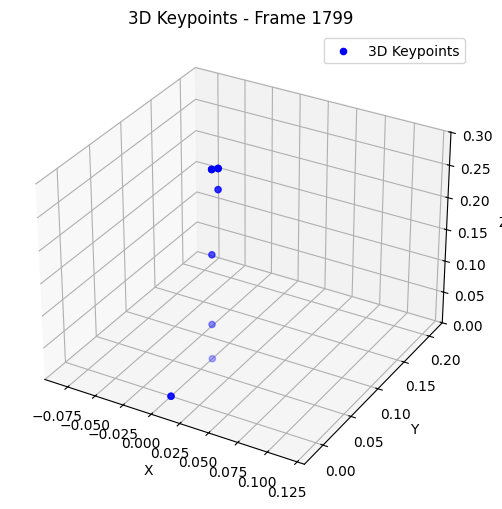

In [ ]:
def load_motion(pkl_file):
    with open(pkl_file, 'rb') as f:
        data = pickle.load(f)
    motion = data.get('full_pose')
    return motion # (seq_len, 24, 3)

pkl_file = "motion_data.pkl"
motion_data = load_motion(pkl_file)

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

def animate_motion(motion_data, interval=50):
    """
    Create an animation of the motion data in a Jupyter Notebook.
    
    Args:
    - motion_data (np.ndarray): Array of shape (seq_len, 24, 3).
    - interval (int): Time interval between frames in milliseconds.
    
    Returns:
    - animation: The Matplotlib animation object.
    """
    seq_len, n_keypoints, _ = motion_data.shape

    fig = plt.figure(figsize=(8, 6))
    ax = fig.add_subplot(111, projection='3d')
    
    # Scatter plot for keypoints
    scatter = ax.scatter([], [], [], c='blue', label="3D Keypoints")

    # Setting the limits of the plot
    ax.set_xlim([motion_data[..., 0].min(), motion_data[..., 0].max()])
    ax.set_ylim([motion_data[..., 1].min(), motion_data[..., 1].max()])
    ax.set_zlim([motion_data[..., 2].min(), motion_data[..., 2].max()])
    
    ax.set_xlabel("X")
    ax.set_ylabel("Y")
    ax.set_zlabel("Z")
    ax.set_title("3D Keypoints Animation")
    ax.legend()

    def update(frame):
        # Update the scatter plot with new frame data
        keypoints = motion_data[frame]
        scatter._offsets3d = (keypoints[:, 0], keypoints[:, 1], keypoints[:, 2])
        ax.set_title(f"3D Keypoints - Frame {frame}")

    # Create the animation
    anim = FuncAnimation(fig, update, frames=seq_len, interval=interval, repeat=True)
    return anim
